In [177]:
import pandas as pd
import numpy as np
import os, sys
import matplotlib.pyplot as plt
import pickle
import datetime as dt
import math
from sklearn.linear_model import LinearRegression

In [178]:
PATH_ROOT_INTERIM_DATA = 'data\\interim'
INTERIM_DATA_NAME = 'covid_19_fulldata.pkl'

In [179]:
covid19_data = pickle.load(open(os.path.join(PATH_ROOT_INTERIM_DATA,INTERIM_DATA_NAME), "rb" ))

In [180]:
covid19_data

,Confirmed,Country/Region,Deaths,Last Update,Latitude,Longitude,Province/State,Recovered
0,1.0,Mainland China,NaN,2020-01-22 17:00:00,NaN,NaN,Anhui,NaN
1,14.0,Mainland China,NaN,2020-01-22 17:00:00,NaN,NaN,Beijing,NaN
2,6.0,Mainland China,NaN,2020-01-22 17:00:00,NaN,NaN,Chongqing,NaN
3,1.0,Mainland China,NaN,2020-01-22 17:00:00,NaN,NaN,Fujian,NaN
4,NaN,Mainland China,NaN,2020-01-22 17:00:00,NaN,NaN,Gansu,NaN
...,...,...,...,...,...,...,...,...
6433,0.0,Guernsey,0.0,2020-03-17 18:33:03,49.4500,-2.5800,NaN,0.0
6434,0.0,Jersey,0.0,2020-03-17 18:33:03,49.1900,-2.1100,NaN,0.0
6435,0.0,Puerto Rico,0.0,2020-03-17 16:13:14,18.2000,-66.5000,NaN,0.0
6436,0.0,Republic of the Congo,0.0,2020-03-17 21:33:03,-1.4400,15.5560,NaN,0.0


In [181]:
covid19_data["Last Update"] = covid19_data["Last Update"].dt.date

In [182]:
group_by_country = covid19_data.groupby(["Country/Region","Last Update"]).sum().reset_index()

In [183]:
group_by_country.head()

,Country/Region,Last Update,Confirmed,Deaths,Latitude,Longitude,Recovered
0,Azerbaijan,2020-02-28,1.0,0.0,0.0,0.0,0.0
1,Afghanistan,2020-02-24,13.0,0.0,231.0,455.0,0.0
2,Afghanistan,2020-03-08,8.0,0.0,66.0,130.0,0.0
3,Afghanistan,2020-03-10,5.0,0.0,33.0,65.0,0.0
4,Afghanistan,2020-03-11,21.0,0.0,99.0,195.0,0.0


In [184]:
group_by_country.fillna(0)

,Country/Region,Last Update,Confirmed,Deaths,Latitude,Longitude,Recovered
0,Azerbaijan,2020-02-28,1.0,0.0,0.0000,0.0000,0.0
1,Afghanistan,2020-02-24,13.0,0.0,231.0000,455.0000,0.0
2,Afghanistan,2020-03-08,8.0,0.0,66.0000,130.0000,0.0
3,Afghanistan,2020-03-10,5.0,0.0,33.0000,65.0000,0.0
4,Afghanistan,2020-03-11,21.0,0.0,99.0000,195.0000,0.0
...,...,...,...,...,...,...,...
1798,Vietnam,2020-03-15,56.0,0.0,14.0583,108.2772,16.0
1799,Vietnam,2020-03-16,61.0,0.0,14.0583,108.2772,16.0
1800,Vietnam,2020-03-17,66.0,0.0,14.0583,108.2772,16.0
1801,occupied Palestinian territory,2020-03-10,25.0,0.0,31.9522,35.2332,0.0


In [185]:
group_by_country.set_index('Last Update', inplace=True)

In [186]:
group_by_country.sort_index(inplace=True)

In [187]:
group_by_country["Con_Virus"] = group_by_country["Confirmed"] - group_by_country["Recovered"] - group_by_country["Deaths"]

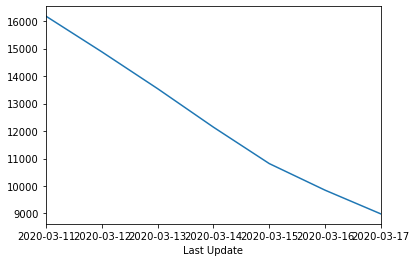

In [188]:
group_by_country[group_by_country["Country/Region"] == "China"]["Con_Virus"].plot()

In [189]:
coef_list={}
for country in group_by_country["Country/Region"].unique():
    country_data = group_by_country[group_by_country["Country/Region"] == country]
    if len(country_data) <= 2:
        pass
    reg = LinearRegression().fit(country_data["Last Update"], country_data["Last Update"])

KeyError: 'Last Update'

In [190]:
group_by_country["LogConfirmed"] = np.log10(group_by_country["Confirmed"])

c:\users\g.martinez.bidal\appdata\local\programs\python\python38\lib\site-packages\pandas\core\series.py:856: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [191]:
group_by_country["LogDeaths"] = np.log10(group_by_country["Deaths"])

In [192]:
group_by_country["LogRecovered"] = np.log10(group_by_country["Recovered"])

In [193]:
group_by_country

,Country/Region,Confirmed,Deaths,Latitude,Longitude,Recovered,Con_Virus,LogConfirmed,LogDeaths,LogRecovered
Last Update,,,,,,,,,,
2020-01-22,Japan,2.0,0.0,0.0000,0.0000,0.0,2.0,0.301030,-inf,-inf
2020-01-22,Mainland China,547.0,17.0,0.0000,0.0000,28.0,502.0,2.737987,1.230449,1.447158
2020-01-22,Thailand,2.0,0.0,0.0000,0.0000,0.0,2.0,0.301030,-inf,-inf
2020-01-22,Macau,1.0,0.0,0.0000,0.0000,0.0,1.0,0.000000,-inf,-inf
2020-01-22,Taiwan,1.0,0.0,0.0000,0.0000,0.0,1.0,0.000000,-inf,-inf
...,...,...,...,...,...,...,...,...,...,...
2020-03-17,Iran,16169.0,988.0,32.4279,53.6880,5389.0,9792.0,4.208683,2.994757,3.731508
2020-03-17,Iraq,154.0,11.0,33.2232,43.6793,32.0,111.0,2.187521,1.041393,1.505150
2020-03-17,Ireland,223.0,2.0,53.1424,-7.6921,5.0,216.0,2.348305,0.301030,0.698970


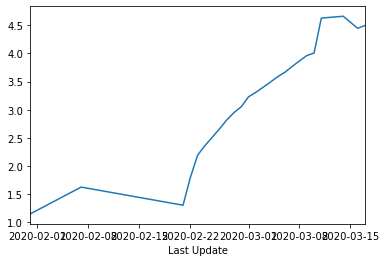

In [194]:
group_by_country[group_by_country["Country/Region"] == "Italy"]["LogConfirmed"].plot()

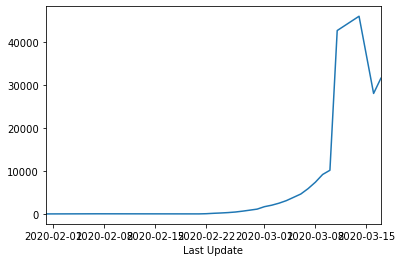

In [195]:
group_by_country[group_by_country["Country/Region"] == "Italy"]["Confirmed"].plot()

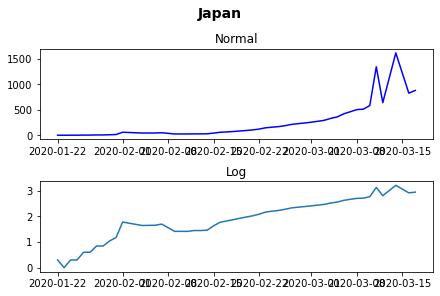

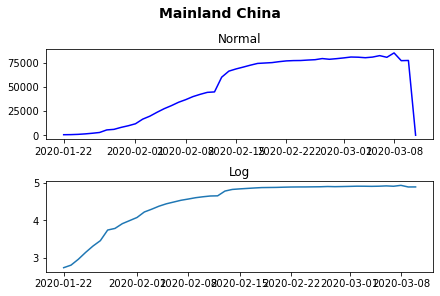

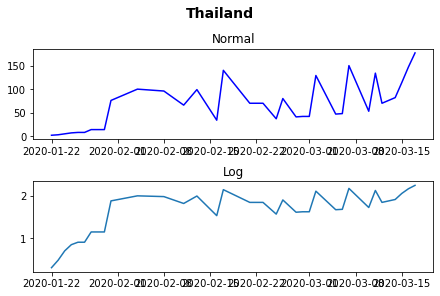

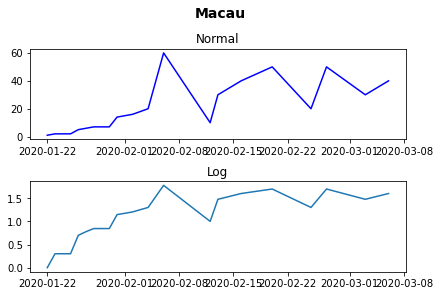

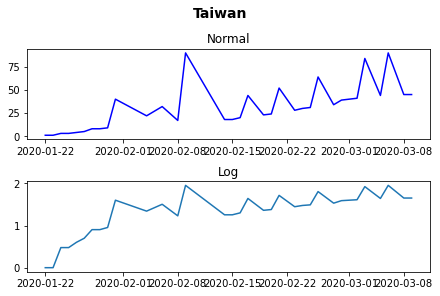

...

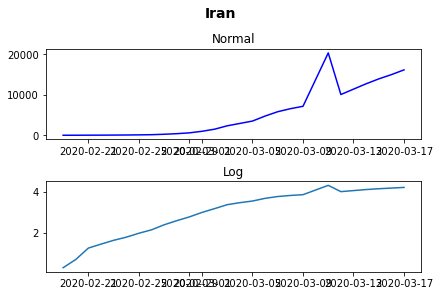

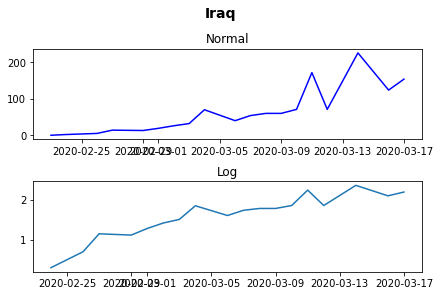

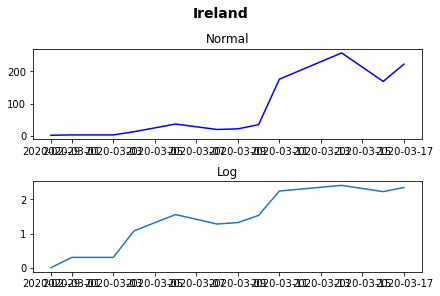

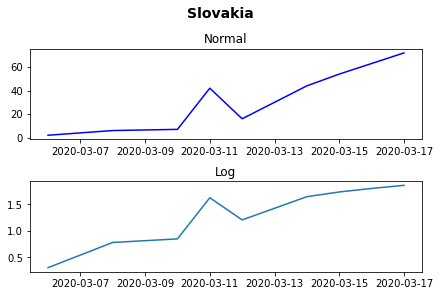

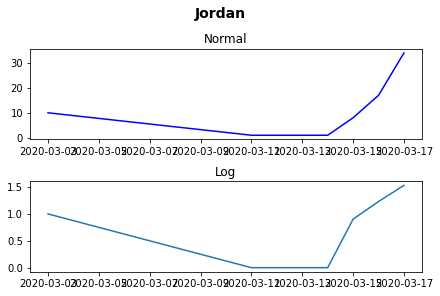

In [196]:
for i, country in enumerate(group_by_country["Country/Region"]):
    '''This function plots 
    1. Total Cases and daily increment
    2. Proportion of increment among total cases
    '''
    
    fig, axs = plt.subplots(2, 1, constrained_layout=True)
    data_to_plot = group_by_country[group_by_country['Country/Region']==country]

    tot_cases = axs[0].plot(data_to_plot['Confirmed'], color='blue', label='Total Cases')
    axs[0].set_title('Normal')

    prop_increment = axs[1].plot(data_to_plot['LogConfirmed'])
    axs[1].set_title('Log')

    fig.suptitle(country, fontsize=14, fontweight='bold')
    plt.show()
